In [1]:
## add the sys function part else there will be file loading errors.
import sys
import warnings
sys.path.insert(1,'../functions')
warnings.filterwarnings("ignore", category=DeprecationWarning) 

In [141]:
import numpy as np
import pandas as pd
import math 
import io_pipe
import nd_index
import lst 
import plot_utils
from matplotlib import pyplot as plt
from matplotlib.colors import Normalize
import logging
from eolearn.io import get_available_timestamps
import pdb
import geopandas as gpd

In [3]:
from skimage.feature import blob_dog, blob_log, blob_doh
from skimage.color import rgb2gray
from sklearn.preprocessing import scale

/Users/kshuiiiiiii/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [4]:
%matplotlib inline

/Users/kshuiiiiiii/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


##### Using default credential starts from here

In [236]:
year_range = range(2014,2019)
date_range = [1,30]
month_range = [6,9]

In [237]:
eopatch_data,vtimestamp = io_pipe.get_landsat8_range(#config = vconfig,
                                                     year_range=year_range,month=month_range,
                                                    date_range=date_range,maxcc=.2)

In [238]:
vtimestamp

[datetime.datetime(2014, 6, 10, 10, 3, 26),
 datetime.datetime(2015, 7, 31, 10, 3, 22),
 datetime.datetime(2015, 9, 1, 10, 3, 33),
 datetime.datetime(2015, 9, 17, 10, 3, 41),
 datetime.datetime(2016, 8, 18, 10, 3, 50),
 datetime.datetime(2017, 6, 2, 10, 3, 21),
 datetime.datetime(2017, 8, 5, 10, 3, 44),
 datetime.datetime(2018, 6, 5, 10, 2, 31)]

In [239]:
NDVI_REF = nd_index.calc_ndvi(eopatch_data)
B10 = eopatch_data[:,:,:,9]-273
B11 = eopatch_data[:,:,:,10]-273
vLSE = lst.LSE(NDVI_REF)
vLST = lst.mono_LST(B10,vLSE)
## use datamask for plot/NDVI/LST.
vR = eopatch_data[:,:,:,3]
vG = eopatch_data[:,:,:,2]
vB = eopatch_data[:,:,:,1]
vImg = np.stack([vR,vG,vB],axis =3)
vImg = (vImg *(255/  np.max(vImg))).astype(np.uint8)
vImg = (vImg*(3.5/255))

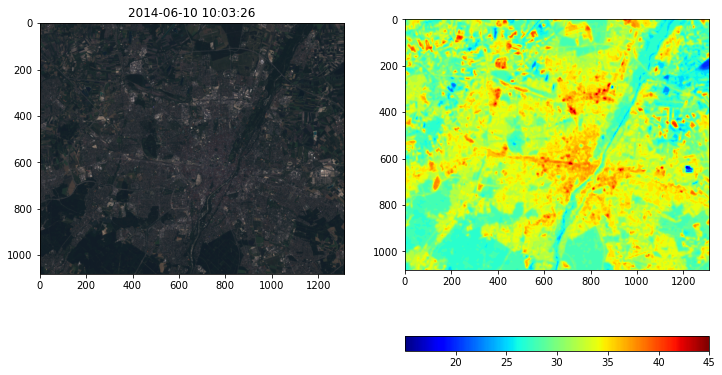

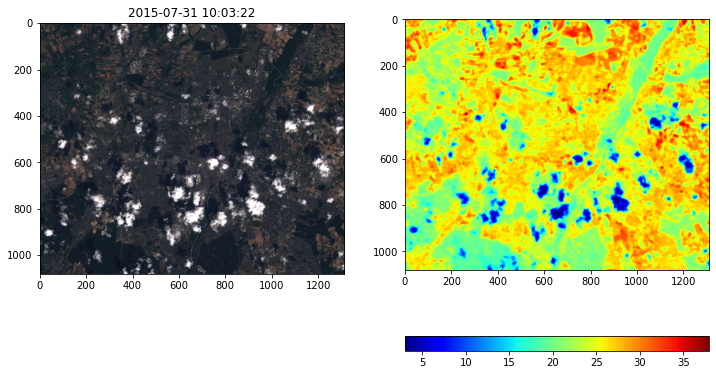

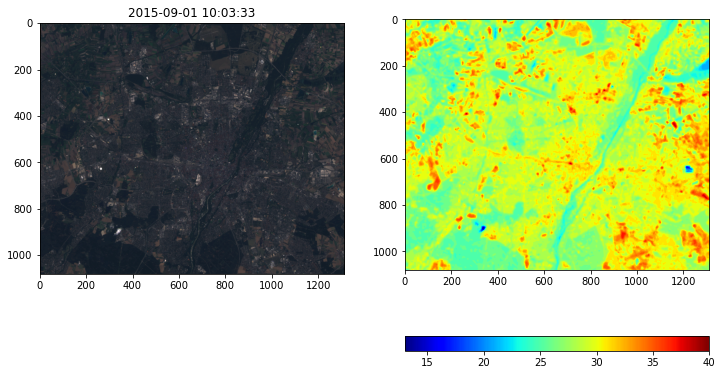

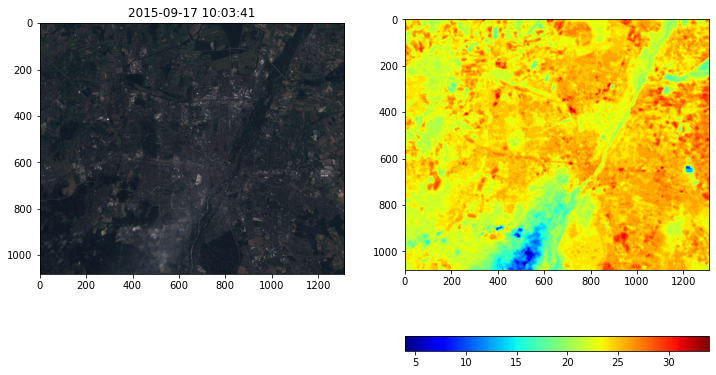

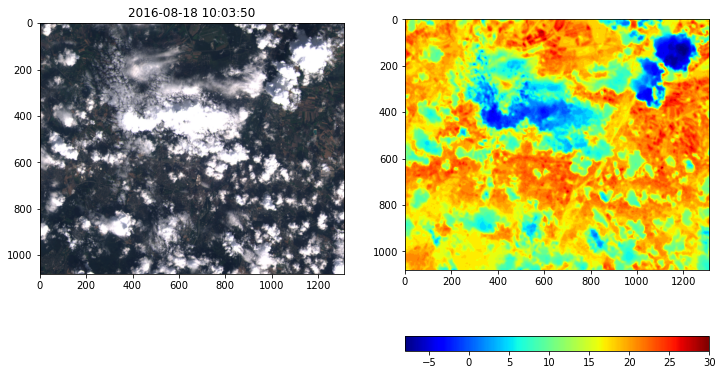

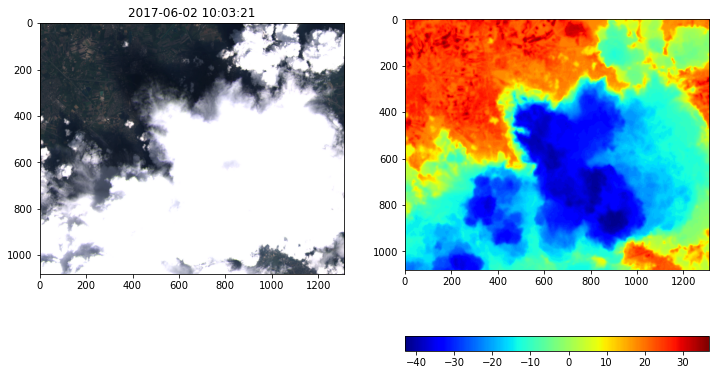

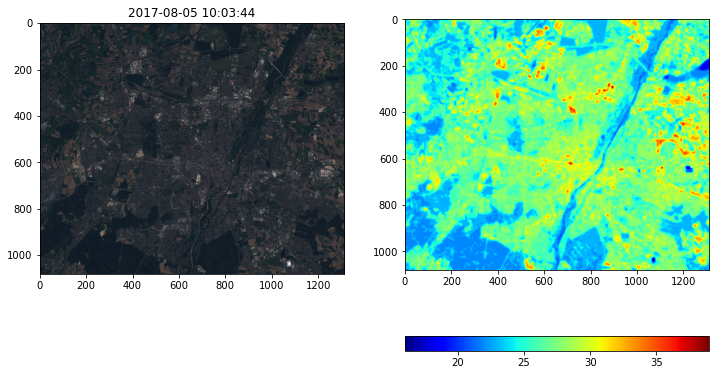

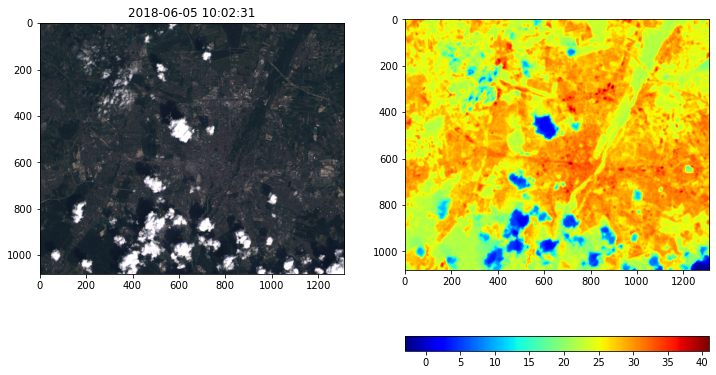

In [240]:
plot_utils.plot_all_LST(vImg,vLST,vtimestamp)

# Heat Island Detection

In [241]:
vdesired = vLST[-1]
vOriginal = vImg[-1]
vgray = rgb2gray(vdesired)
vgray = scale(vgray,axis=0, with_mean=True, copy=True)

/Users/kshuiiiiiii/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: The behavior of rgb2gray will change in scikit-image 0.19. Currently, rgb2gray allows 2D grayscale image to be passed as inputs and leaves them unmodified as outputs. Starting from version 0.19, 2D arrays will be treated as 1D images with 3 channels.
  This is separate from the ipykernel package so we can avoid doing imports until


In [242]:
plt.rcParams['figure.figsize'] = (30,30)

/Users/kshuiiiiiii/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [243]:
def plot_islands(date, original,lst,detected_island,show_nr = False,limit=None,enhance_radius=False):
    fig, axes = plt.subplots(1, 2, figsize=(40, 40), sharex=True, sharey=True)
    ax = axes.ravel()
    #plt.imshow(vLST[0],cmap='gray')
    ax[0].imshow(original)
    ax[0].set_title(date, fontsize = 30)
    im = ax[1].imshow(lst,cmap=plt.cm.jet)
    ax[1].set_title(date, fontsize = 30)
    index = 1
    for blob in detected_island:
        y, x, r = blob
        if limit is None:
            if enhance_radius:
                c = plt.Circle((x, y), r*3, color='white', linewidth=2, fill=False)
            else:
                c =plt.Circle((x, y), r, color='white', linewidth=2, fill=False)
            if show_nr:
                ax[0].text(x, y+50, '%.0f'% math.log2(index), fontsize=40, color='white')
                ax[1].text(x, y+50, '%.0f'% math.log2(index), fontsize=40, color='black')
                index += index
            c2 = plt.Circle((x, y), r, color='black', linewidth=2, fill=False)
            ax[0].add_patch(c)
            ax[1].add_patch(c2)
        else:            
            if r>limit:
                if enhance_radius:
                    print("here")
                    c = plt.Circle((x, y), r*3, color='white', linewidth=2, fill=False)
                else:
                    c = plt.Circle((x, y), r, color='white', linewidth=2, fill=False)
                if show_nr:
                    ax[0].text(x, y+50, '%.0f'% math.log2(index), fontsize=40, color='white')
                    ax[1].text(x, y+50, '%.0f'% math.log2(index), fontsize=40, color='black')
                    index += index
                c2 = plt.Circle((x, y), r, color= 'black', linewidth=2, fill=False)
                ax[0].add_patch(c)
                ax[1].add_patch(c2)
    plt.show()

## Determinant of Hessian (DoH)

In [245]:
blobs = blob_doh(vgray, max_sigma=9, threshold=.1)

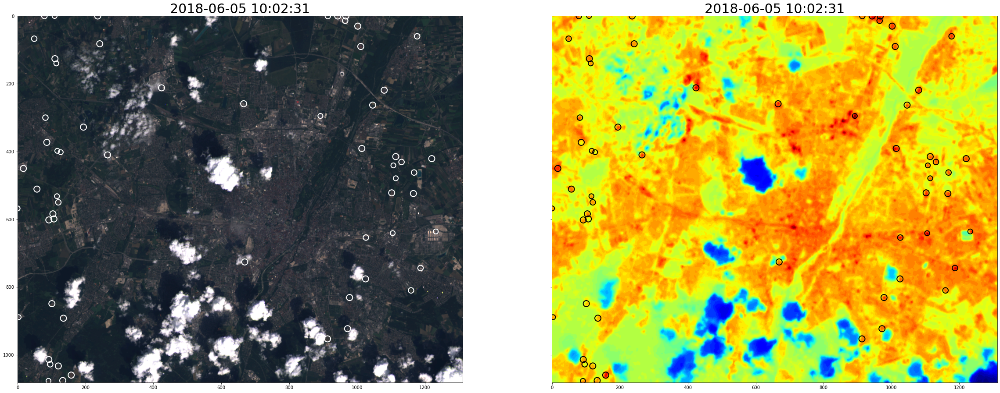

In [246]:
plot_islands(vtimestamp[-1],vOriginal,vdesired,blobs)

### Using Threshold on the basis avg temperature of a patch

In [247]:
vfinal = lst.temperature_threshold(vdesired, blobs)

../functions/lst.py:53: RuntimeWarning: Mean of empty slice.
  vmean = vdesired[y - vrange:y + vrange, x - vrange:x + vrange].mean()
/Users/kshuiiiiiii/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


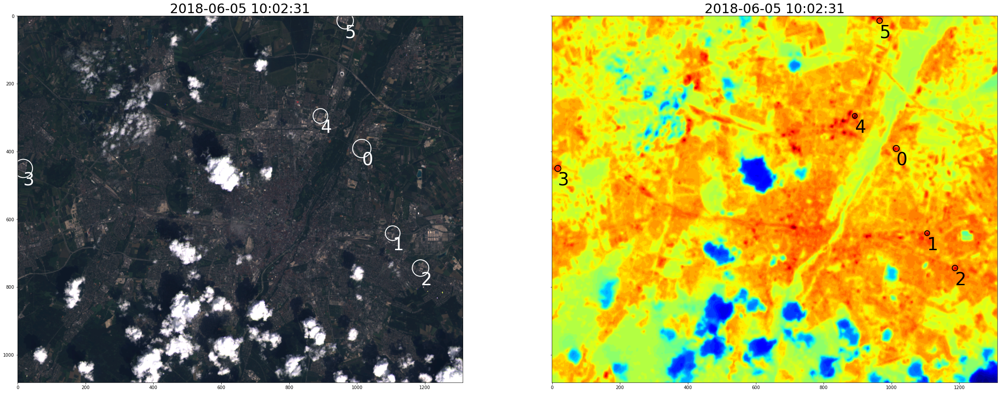

In [248]:
plot_islands(vtimestamp[-1], vOriginal,vdesired,vfinal,show_nr = True, enhance_radius=True)

## Plot time series

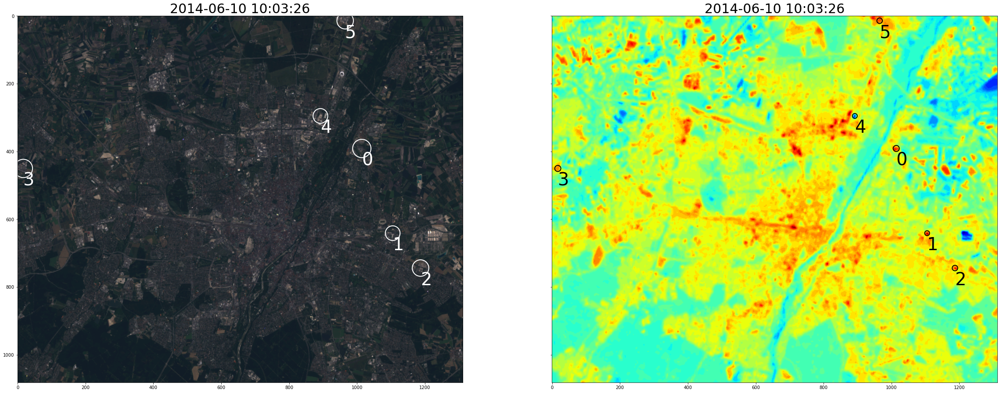

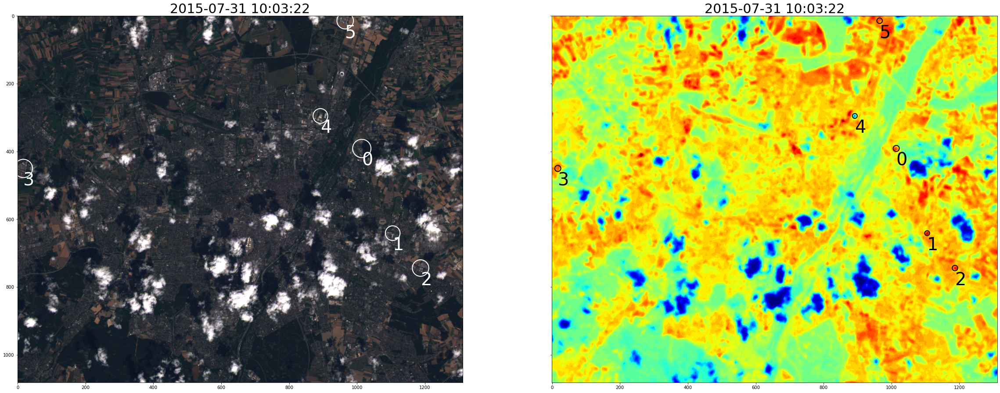

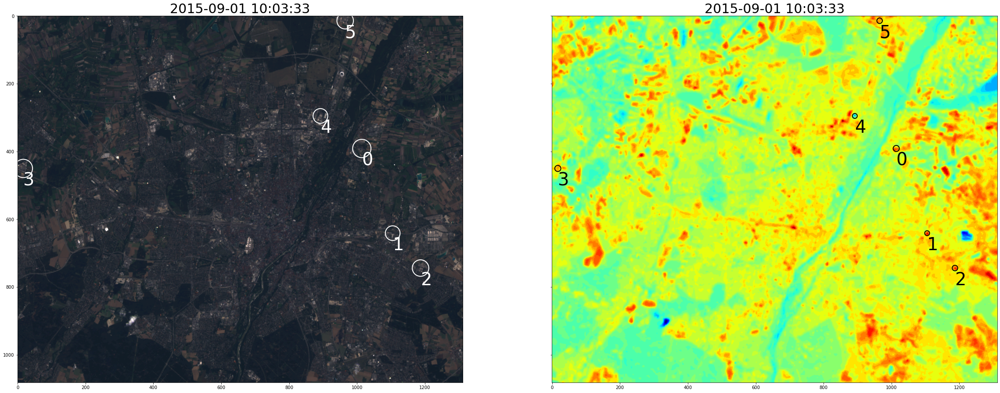

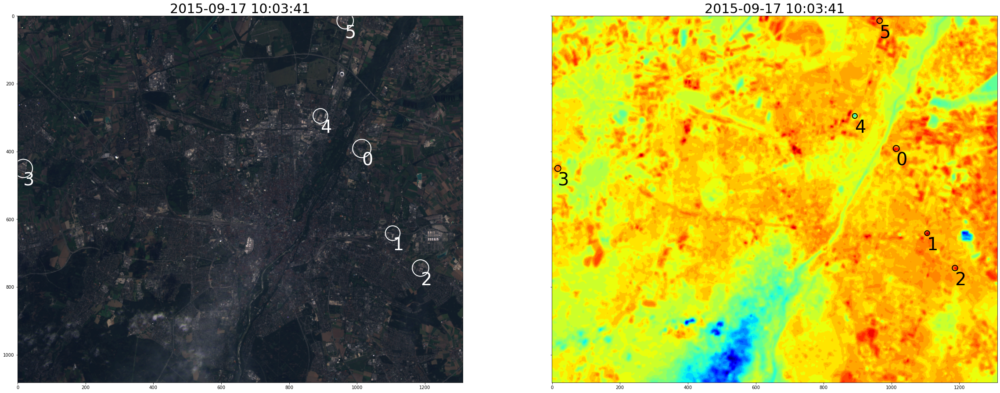

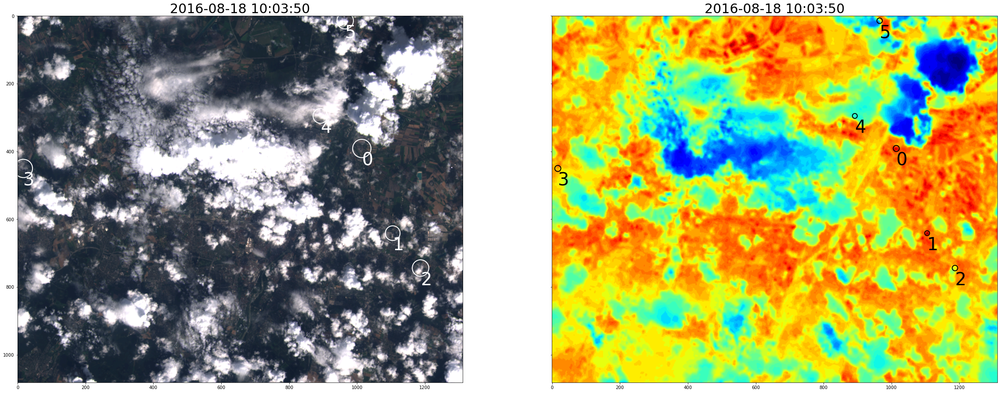

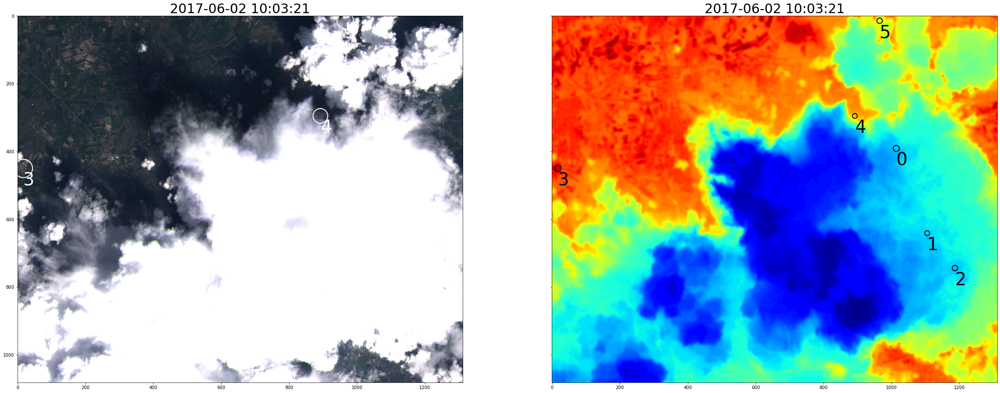

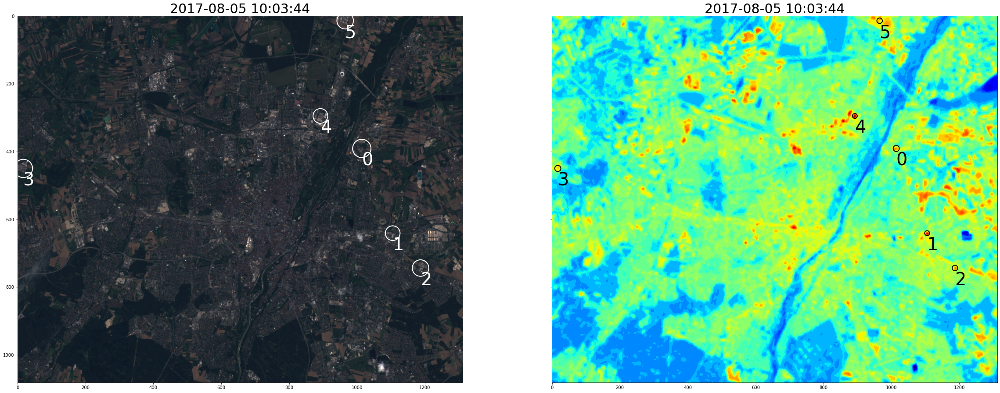

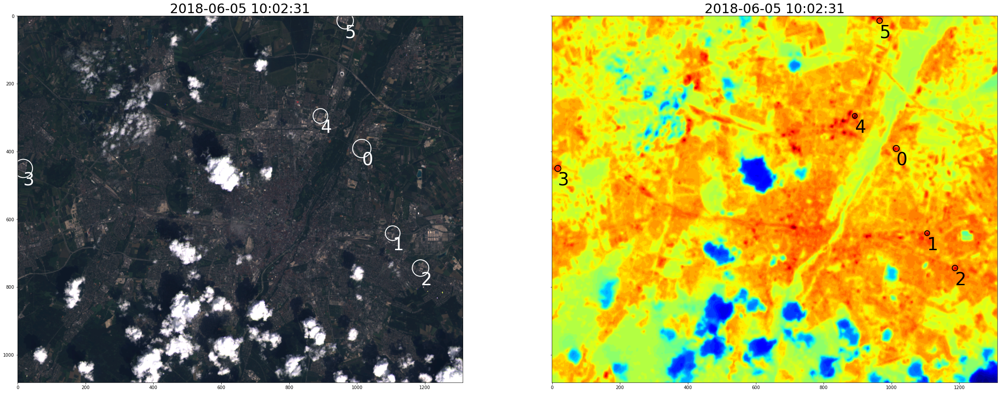

In [249]:
for i in range(len(vtimestamp)):
    plot_islands(vtimestamp[i],vImg[i],vLST[i],vfinal,show_nr = True,enhance_radius=True)

## Analysis

In [250]:
data = []
for island in range(len(vfinal)):
    tmp = []
    for time in range(len(vtimestamp)):
        tmp.append(vLST[time,int(vfinal[island,0]),int(vfinal[island,1])])
    data.append(tmp)

In [262]:
df = pd.DataFrame(data,columns=vtimestamp,index=range(len(vfinal)))
df = df.drop(df.columns[5], axis=1)
df

,2014-06-10 10:03:26,2015-07-31 10:03:22,2015-09-01 10:03:33,2015-09-17 10:03:41,2016-08-18 10:03:50,2017-08-05 10:03:44,2018-06-05 10:02:31
0,40.0,31.0,34.0,30.0,27.0,33.0,36.0
1,44.0,36.0,38.0,33.0,29.0,38.0,40.0
2,42.0,34.0,36.0,31.0,15.0,34.0,38.0
3,38.0,31.0,33.0,28.0,20.0,31.0,35.0
4,20.0,11.0,22.0,15.0,7.0,39.0,41.0
5,40.0,31.0,33.0,28.0,10.0,32.0,35.0


### Plot the development of single heat island

/Users/kshuiiiiiii/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


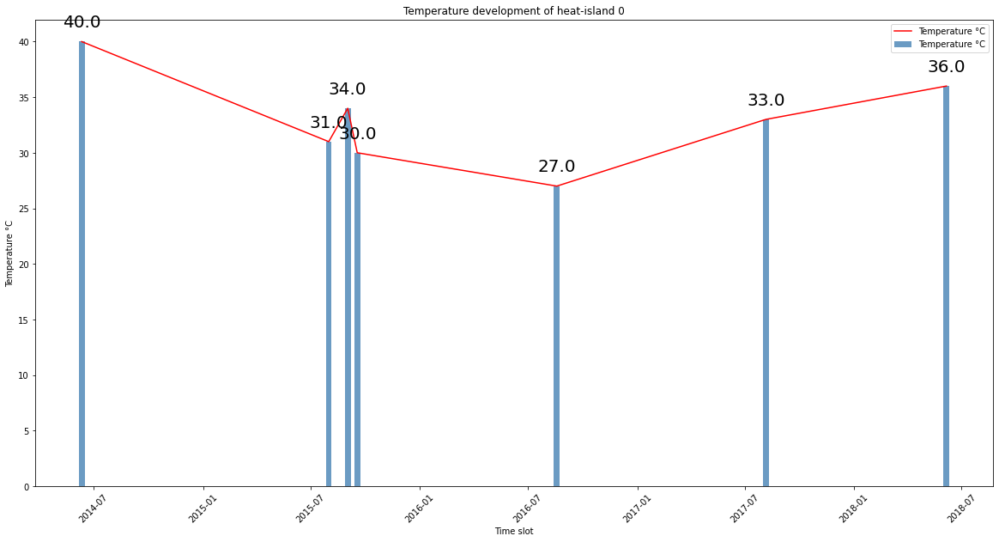

In [277]:
island = 0
f = plt.figure(figsize=(20,10))
ax = plt.subplot(111)

x = df.columns
y = round(df.iloc[island])
plt.bar(x=x, height=y, width=10, label='Temperature °C', color='steelblue', alpha=0.8)
for x1, yy in zip(x, y):
    plt.text(x1, yy + 1, str(yy), ha='center', va='bottom', fontsize=20, rotation=0)
plt.title("Temperature development of heat-island %.0f" %island)
plt.xlabel("Time slot")
plt.ylabel("Temperature °C")
plt.plot(x, y, "r", ms=10, label="Temperature °C")
plt.xticks(rotation=45)
plt.legend()
plt.show()

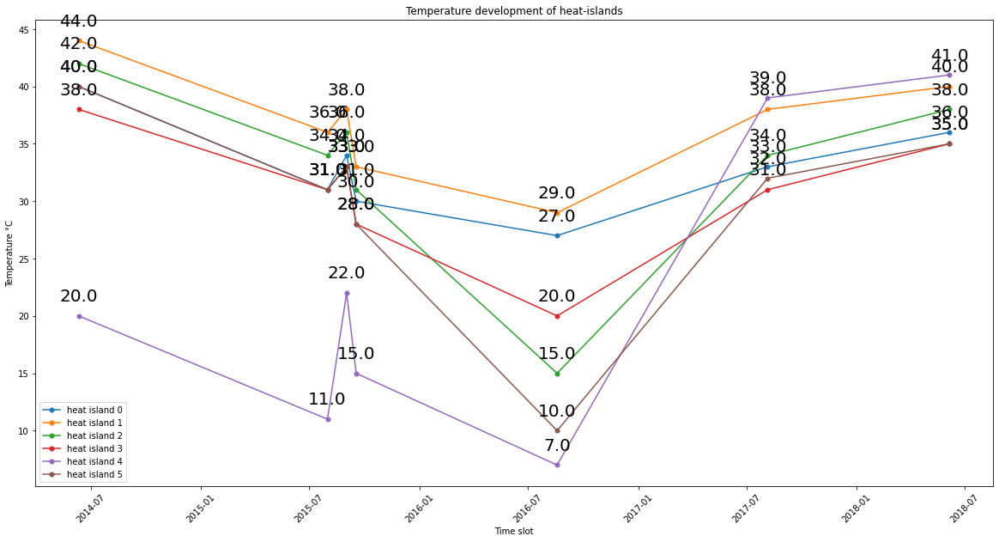

In [289]:
f = plt.figure(figsize=(20,10))
ax = plt.subplot(111)

for island in range(df.shape[0]):
    x = df.columns
    y = round(df.iloc[island])
    #plt.bar(x=x, height=y, width=10, label='Temperature °C', color='steelblue', alpha=0.8)
    for x1, yy in zip(x, y):
        plt.text(x1, yy + 1, str(yy), ha='center', va='bottom', fontsize=20, rotation=0)
    plt.plot(x, y, marker='.', ms=10, label="heat island %.0f" %island)
    plt.xticks(rotation=45)

plt.title("Temperature development of heat-islands")
plt.legend()
plt.xlabel("Time slot")
plt.ylabel("Temperature °C")
plt.show()